In [48]:
import pandas as pd
import numpy as np 
import json
import csv


import matplotlib.pyplot as plt
from matplotlib import rc
import seaborn as sns

from tqdm import tqdm_notebook as tqdm

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.tokenize import sent_tokenize
from nltk.stem import WordNetLemmatizer 
import nltk
nltk.download('averaged_perceptron_tagger')

import spacy
import math

import string
import sys
import random

from collections import Counter
from itertools import chain

stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/aarunku5/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [49]:
bwords=pd.read_csv("/Users/aarunku5/Desktop/DQI/DQI_Worker/data/SNLI/AFLITE_SPLIT/Final/Test/testbadwords.csv")
df_testbad = pd.read_csv("/Users/aarunku5/Desktop/DQI/DQI_Worker/data/SNLI/AFLITE_SPLIT/Final/Test/testbad.csv")

In [50]:
magwordsb=bwords.final.str.split(expand=True).stack().value_counts()
magwordsb

man           4265
woman         2732
two           1894
people        1800
wearing       1421
              ... 
stationary       1
norwegian        1
dine             1
identity         1
laze             1
Length: 5374, dtype: int64

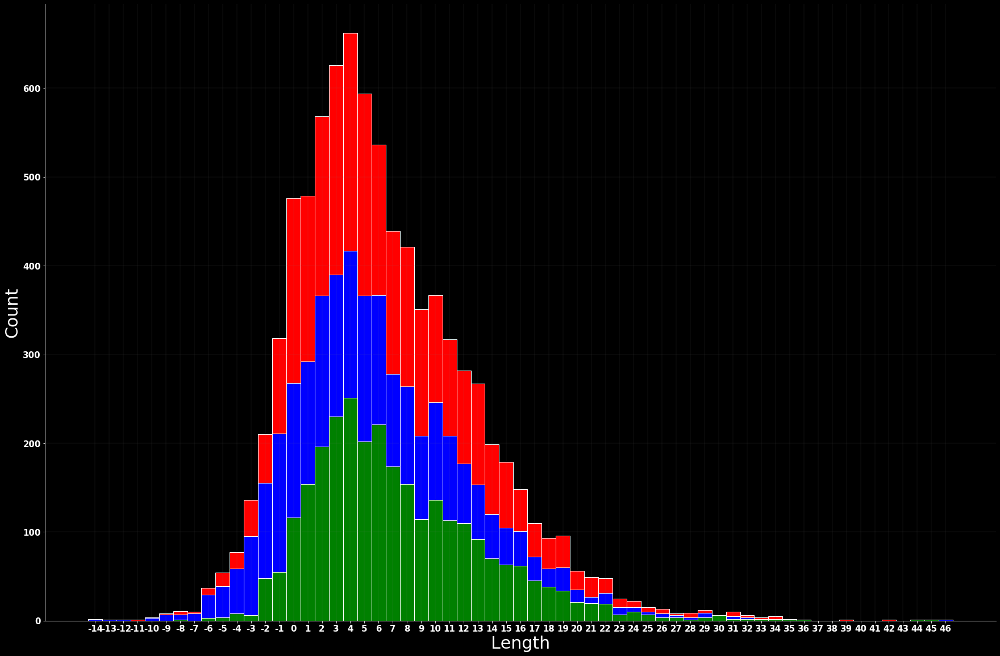

<Figure size 432x288 with 0 Axes>

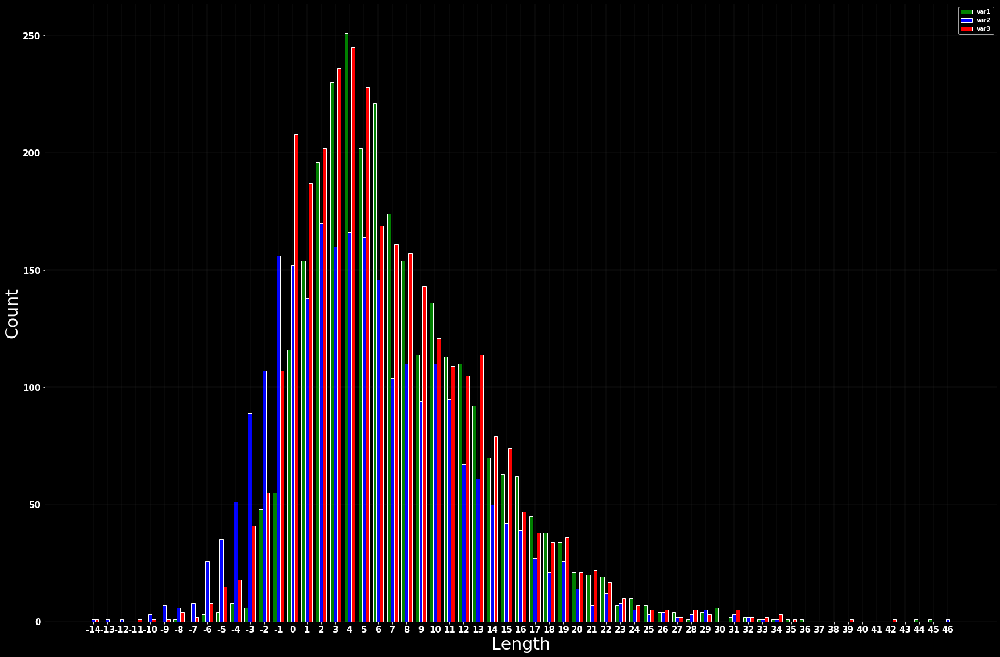

<Figure size 432x288 with 0 Axes>

In [51]:
#Length PH Bad
lengthphb=[]
labelphb=[]
for i in range(8376):
    lengthphb.append(len(bwords.iloc[i]['fullnopunc'].split())-len(bwords.iloc[i+8376]['fullnopunc'].split()))
    labelphb.append(bwords.iloc[i]['label'])
x=[]
e=[]
n=[]
c=[]
for i in range(min(lengthphb),max(lengthphb)+1):
    x.append(i)
    e.append(0)
    n.append(0)
    c.append(0)
for i in range(len(x)):
    for j in range(len(lengthphb)):
        if(lengthphb[j]==x[i]):
            if(labelphb[j]=='entailment'):
                e[i]=e[i]+1
            elif(labelphb[j]=='neutral'):
                n[i]=n[i]+1
            else:
                c[i]=c[i]+1

                rc('font', weight='bold')
bars1 = e
bars2 = n
bars3 = c
bars = np.add(bars1, bars2).tolist()
r = x
names = x
barWidth = 1
fig, ax = plt.subplots(figsize=(30,20))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Length',fontsize=30)
ax.set_ylabel('Count',fontsize=30)
ax.tick_params(axis='both', which='major', labelsize=15)
ax.bar(r, bars1, color='green', edgecolor='white', width=barWidth)
ax.bar(r, bars2, bottom=bars1, color='blue', edgecolor='white', width=barWidth)
ax.bar(r, bars3, bottom=bars, color='red', edgecolor='white', width=barWidth)
plt.xticks(r, names, fontweight='bold')
plt.show()
plt.clf()

barWidth = 0.25 
bars1 = e
bars2 = n
bars3 = c
names=x
r1 = np.arange(len(bars1))
r2 = [x + barWidth for x in r1]
r3 = [x + barWidth for x in r2]
fig, ax = plt.subplots(figsize=(30,20))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Length',fontsize=30)
ax.set_ylabel('Count',fontsize=30)
ax.tick_params(axis='both', which='major', labelsize=15)
ax.bar(r1, bars1, color='green', width=barWidth, edgecolor='white', label='var1')
ax.bar(r2, bars2, color='blue', width=barWidth, edgecolor='white', label='var2')
ax.bar(r3, bars3, color='red', width=barWidth, edgecolor='white', label='var3')
plt.xticks([r + barWidth for r in range(len(bars1))], names)
plt.legend()
plt.show()
plt.clf()




In [52]:
bad=pd.DataFrame(columns=['sample','p','h','lengthph','label','onsc','onshc','onspc','onshpc','osc','oshc','ospc','oshpc'])
bad['lengthph']=lengthphb
bad['sample']=range(8376)
bad['label']=labelphb
bad['p']=bwords.iloc[0:8376]['fullnopunc']
hs=bwords.iloc[8376:16752]['fullnopunc']
hs=hs.reset_index()
hs
bad['h']=hs['fullnopunc']
bad

,sample,p,h,lengthph,label,onsc,onshc,onspc,onshpc,osc,oshc,ospc,oshpc
0,0,This church choir sings to the masses as they ...,The church is filled with song,12,entailment,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,This church choir sings to the masses as they ...,A choir singing at a baseball game,11,contradiction,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,A woman with a green headscarf blue shirt and ...,The woman is young,9,neutral,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,A woman with a green headscarf blue shirt and ...,The woman has been shot,8,contradiction,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,An old man with a package poses in front of an...,A man poses in front of an ad,4,entailment,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8371,8371,Two women are observing something together,Two women are looking at a flower together,-2,neutral,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8372,8372,Two women are observing something together,Two girls are looking at something,0,entailment,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8373,8373,A man in a black leather jacket and a book in ...,A man is flying a kite,11,contradiction,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8374,8374,A man in a black leather jacket and a book in ...,A man is speaking in a classroom,10,entailment,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


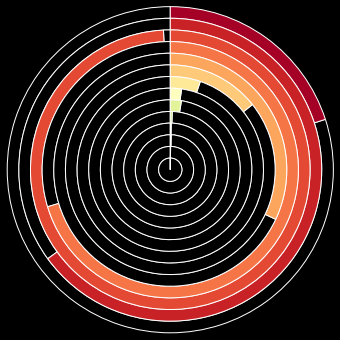

<Figure size 432x288 with 0 Axes>

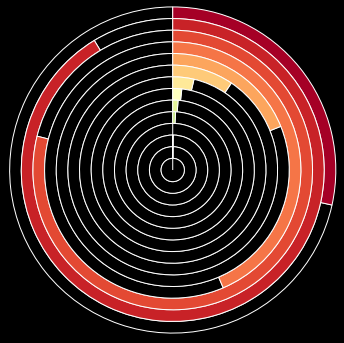

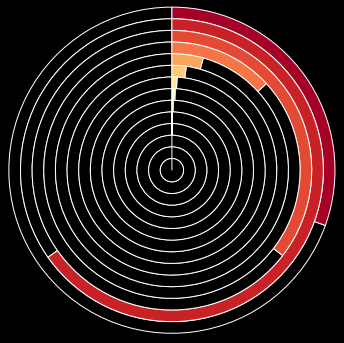

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:141: RuntimeWarning: Second argument 'y1' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


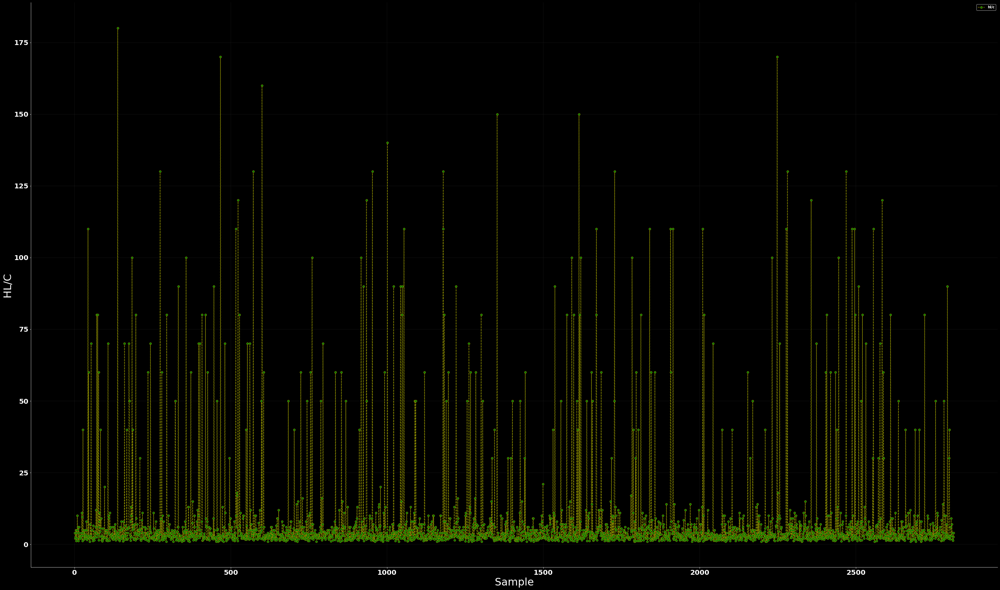

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:152: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

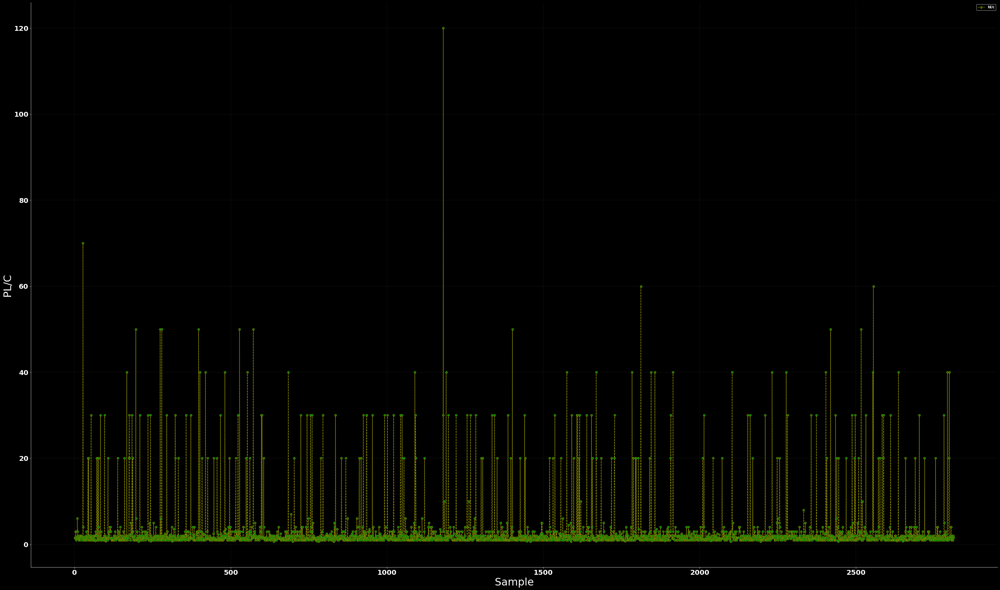

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:163: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

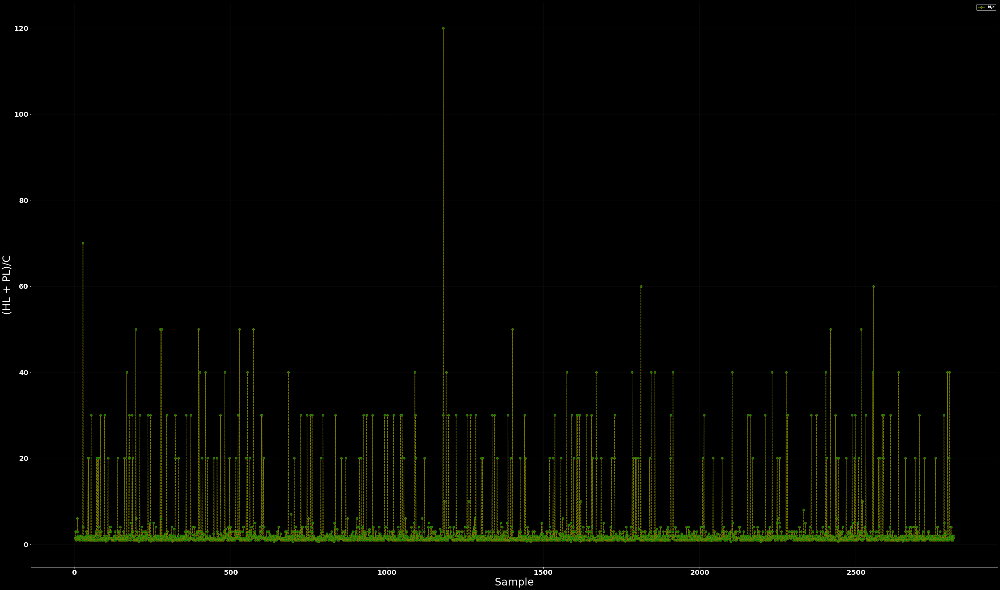

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:176: RuntimeWarning: Second argument 'y1' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

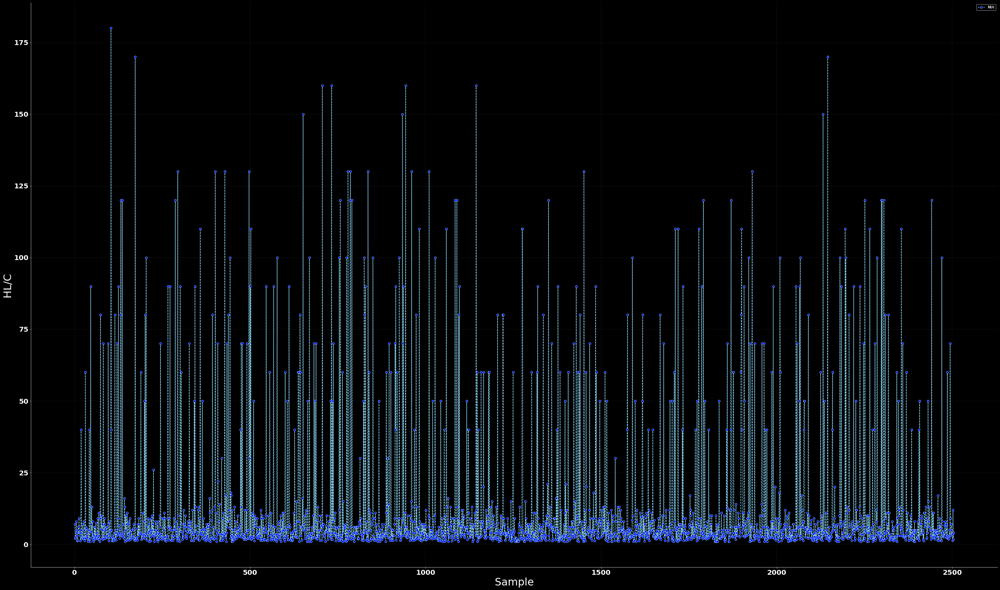

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:187: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

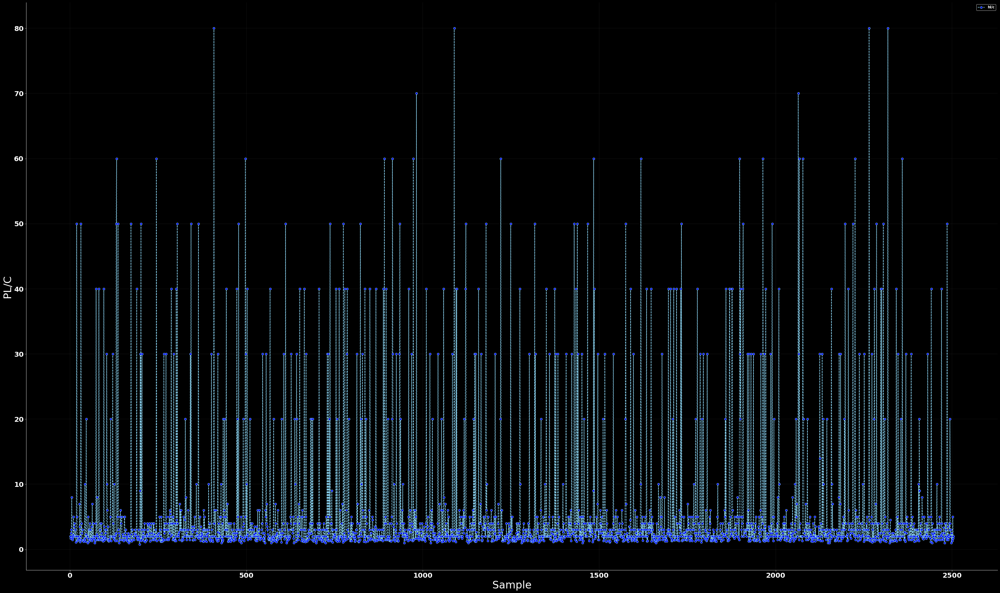

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:198: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

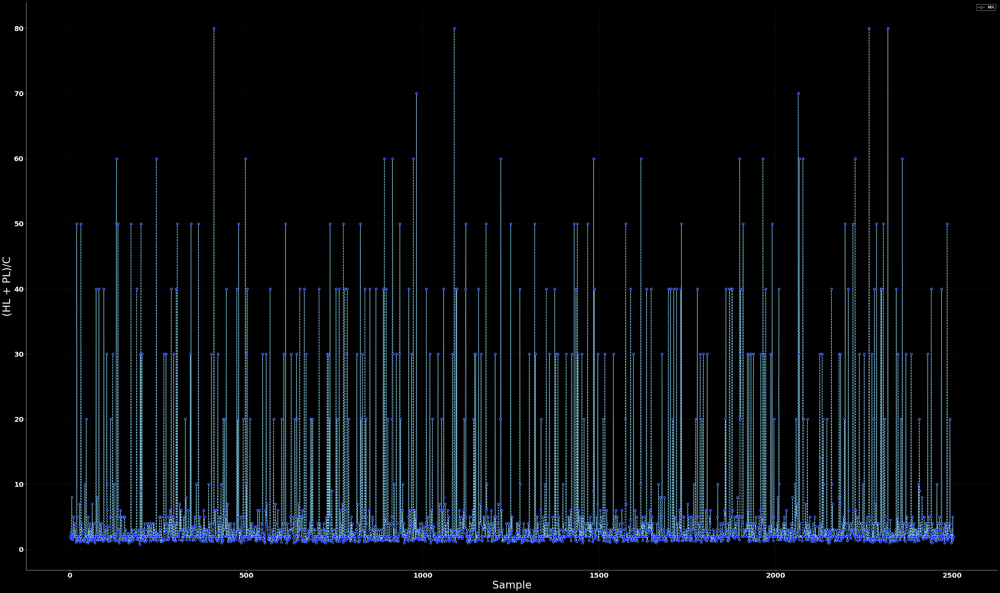

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:211: RuntimeWarning: Second argument 'y1' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

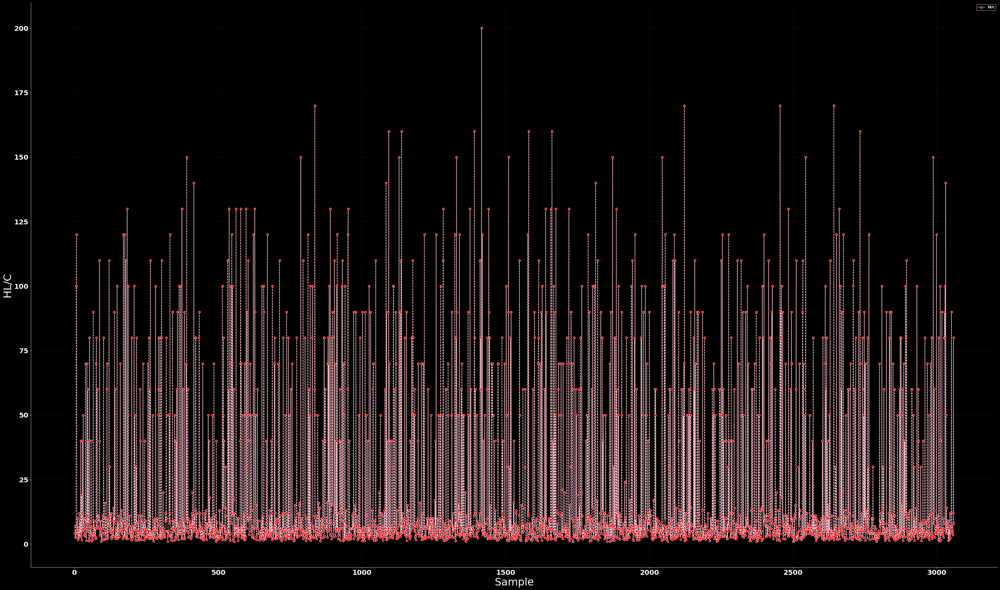

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:222: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

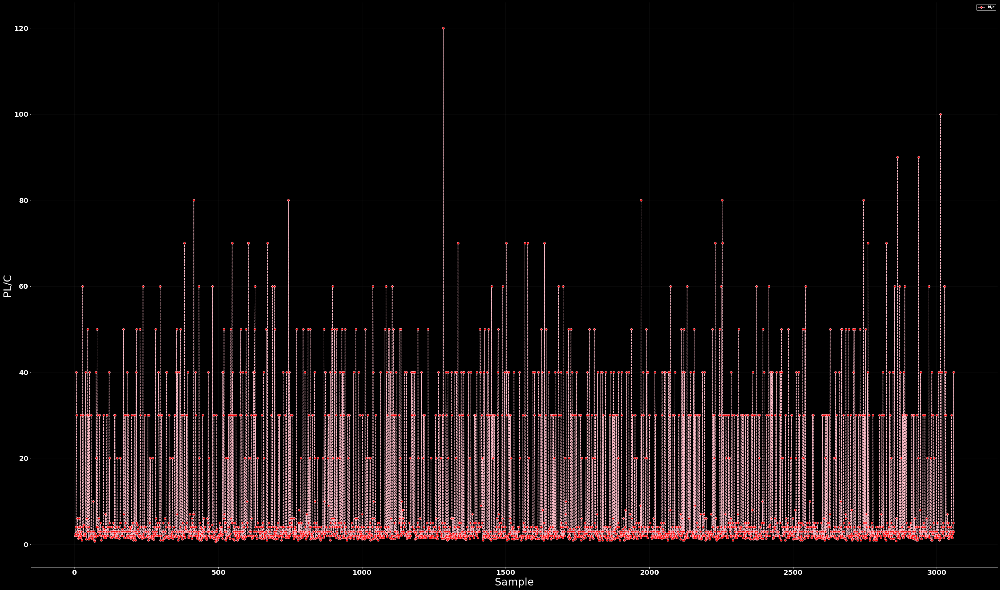

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:233: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

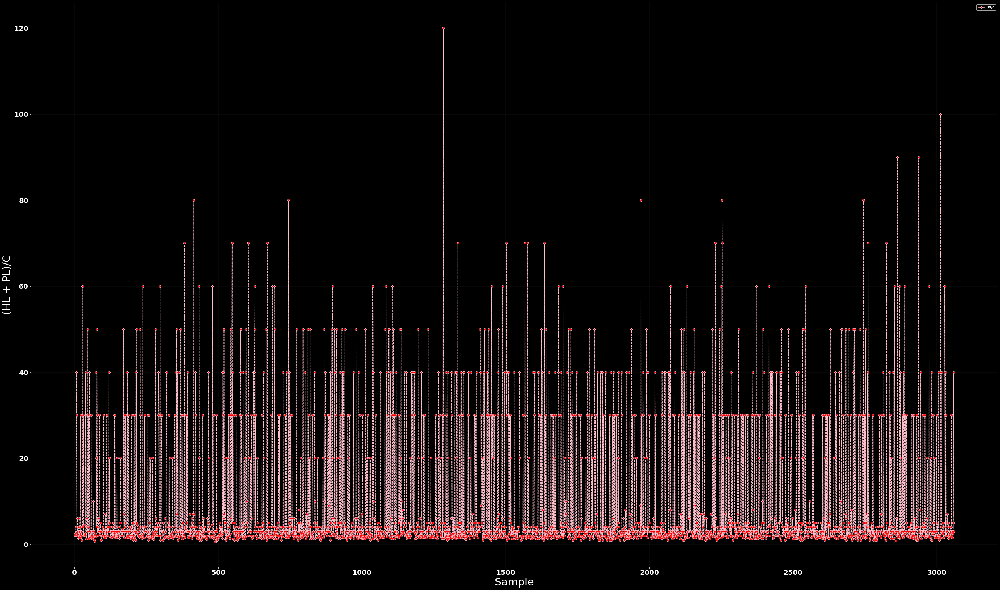

<Figure size 432x288 with 0 Axes>

In [53]:
#Word Overlap No Stop Words Bad
def final(x):
    makeitastring = ' '.join(map(str, x))
    makeitastring=makeitastring.replace(",","")
    makeitastring=makeitastring.replace("'","")
    makeitastring=makeitastring.replace("[","")
    makeitastring=makeitastring.replace("]","")
    return makeitastring
c0=0
arr=[]
arr1=[]
arr2=[]
arr3=[]
x=int(len(bwords)/2)
for i in tqdm(range(x)):
    s=bwords.iloc[i]['final']
    s=s.lower()
    slist=s.split()
    slist = list(dict.fromkeys(slist))
    ss=bwords.iloc[i+x]['final']
    sslist=ss.split()
    sslist = list(dict.fromkeys(sslist))
    s=final(slist)
    ss=final(sslist)
    hl=len(slist)
    pl=len(sslist)
    slist=s.split()
    c=0
    for j in range(len(slist)):
         if(slist[j] in ss):
                c=c+1
    if(c==0):
        c0=c0+1
        c=c+0.1
    arr.append(c)
    arr1.append(hl/c)
    arr2.append(pl/c)
    arr3.append((hl+pl)/c)
xaxis=[]
e=[]
n=[]
c=[]
for i in range(0,int(max(arr))+1):
    xaxis.append(i)
    e.append(0)
    n.append(0)
    c.append(0)
for i in range(len(xaxis)):
    for j in range(len(arr)):
        if(math.floor(arr[j])==xaxis[i]):
            if(labelphb[j]=='entailment'):
                e[i]=e[i]+1
            elif(labelphb[j]=='neutral'):
                n[i]=n[i]+1
            else:
                c[i]=c[i]+1

from matplotlib import cm
from math import log10
labels = xaxis
data = e
nn = len(data)
k = 10 ** int(log10(max(data)))
m = k * (1 + max(data) // k)
plt.style.use('dark_background')
r = 1.5
w = r / nn
colors = [cm.RdYlGn(i / nn) for i in range(nn)]
fig, ax = plt.subplots(figsize=(5,5))
ax.axis("equal")
for i in range(nn):
    innerring, _ = ax.pie([m - data[i], data[i]], radius = r - i * w, startangle = 90, labels = ["", labels[i]], labeldistance = 1 - 1 / (1.5 * (nn - i)), textprops = {"alpha": 0}, colors = ["black", colors[i]])
    plt.setp(innerring, width = w, edgecolor = "white")
plt.show()
plt.clf()
from matplotlib import cm
from math import log10
labels = xaxis
data = n
nn = len(data)
k = 10 ** int(log10(max(data)))
m = k * (1 + max(data) // k)
plt.style.use('dark_background')
r = 1.5
w = r / nn
colors = [cm.RdYlGn(i / nn) for i in range(nn)]
fig, ax = plt.subplots(figsize=(5,5))
ax.axis("equal")
for i in range(nn):
    innerring, _ = ax.pie([m - data[i], data[i]], radius = r - i * w, startangle = 90, labels = ["", labels[i]], labeldistance = 1 - 1 / (1.5 * (nn - i)), textprops = {"alpha": 0}, colors = ["black", colors[i]])
    plt.setp(innerring, width = w, edgecolor = "white")
plt.show()
from matplotlib import cm
from math import log10
labels = xaxis
data = c
nn = len(data)
k = 10 ** int(log10(max(data)))
m = k * (1 + max(data) // k)
plt.style.use('dark_background')
r = 1.5
w = r / nn
colors = [cm.RdYlGn(i / nn) for i in range(nn)]
fig, ax = plt.subplots(figsize=(5,5))
ax.axis("equal")
for i in range(nn):
    innerring, _ = ax.pie([m - data[i], data[i]], radius = r - i * w, startangle = 90, labels = ["", labels[i]], labeldistance = 1 - 1 / (1.5 * (nn - i)), textprops = {"alpha": 0}, colors = ["black", colors[i]])
    plt.setp(innerring, width = w, edgecolor = "white")
plt.show()

e1=[]
e2=[]
e3=[]
n1=[]
n2=[]
n3=[]
c1=[]
c2=[]
c3=[]
for i in range(len(arr1)):
    if(labelphb[i]=='entailment'):
        e1.append(arr1[i])
        e2.append(arr2[i])
        e3.append(arr3[i])
    elif(labelphb[i]=='neutral'):
        n1.append(arr1[i])
        n2.append(arr2[i])
        n3.append(arr3[i])
    else:
        c1.append(arr1[i])
        c2.append(arr2[i])
        c3.append(arr3[i])

df=pd.DataFrame({'x': range(1,len(e1)+1), 'y1': e1, 'y2': e2, 'y3': e3 })
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('HL/C',fontsize=30)
ax.plot( 'x', 'y1', data=df, marker='o', markerfacecolor='green' , color='olive',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('PL/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='green' , color='olive',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('(HL + PL)/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='green' , color='olive',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()

df=pd.DataFrame({'x': range(1,len(n1)+1), 'y1': n1, 'y2': n2, 'y3': n3 })
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('HL/C',fontsize=30)
ax.plot( 'x', 'y1', data=df, marker='o', markerfacecolor='blue' , color='skyblue',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('PL/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='blue' , color='skyblue',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('(HL + PL)/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='blue' , color='skyblue',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()

df=pd.DataFrame({'x': range(1,len(c1)+1), 'y1': c1, 'y2': c2, 'y3': c3 })
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('HL/C',fontsize=30)
ax.plot( 'x', 'y1', data=df, marker='o', markerfacecolor='red' , color='pink',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('PL/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='red' , color='pink',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('(HL + PL)/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='red' , color='pink',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()

bad['onsc']=arr
bad['onshc']=arr1
bad['onspc']=arr2
bad['onshpc']=arr3

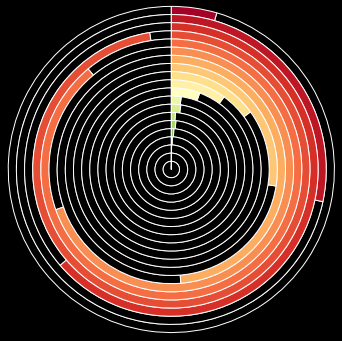

<Figure size 432x288 with 0 Axes>

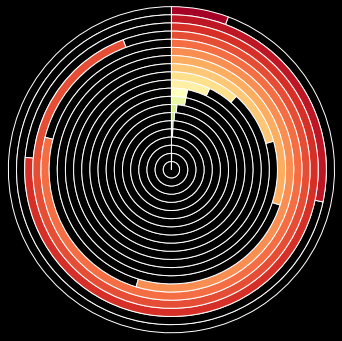

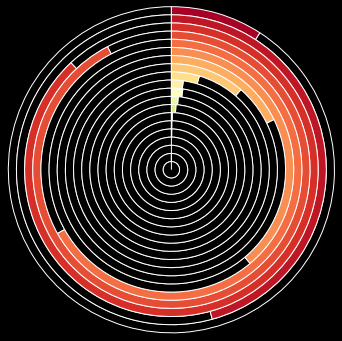

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:141: RuntimeWarning: Second argument 'y1' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


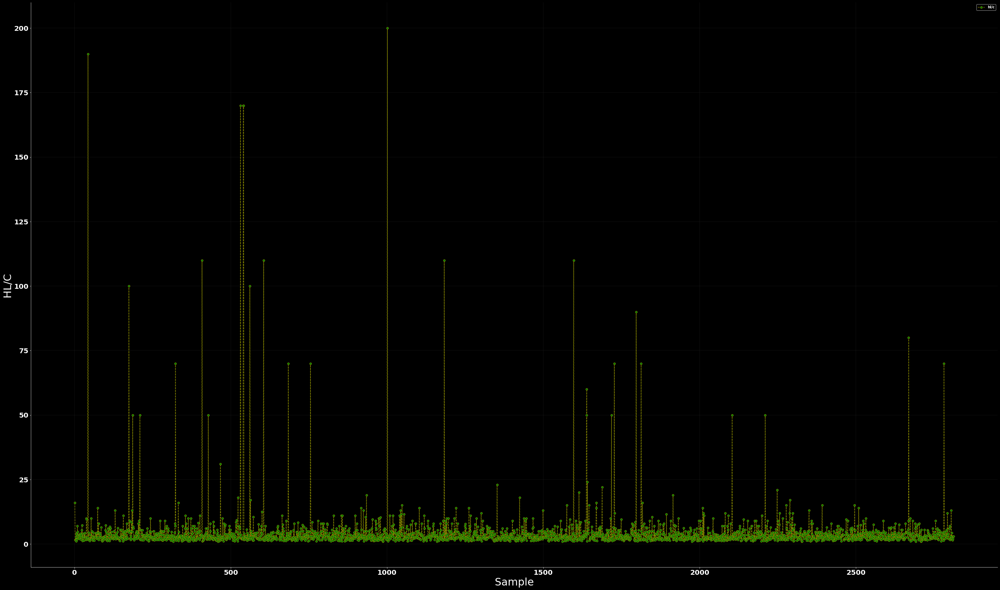

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:152: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

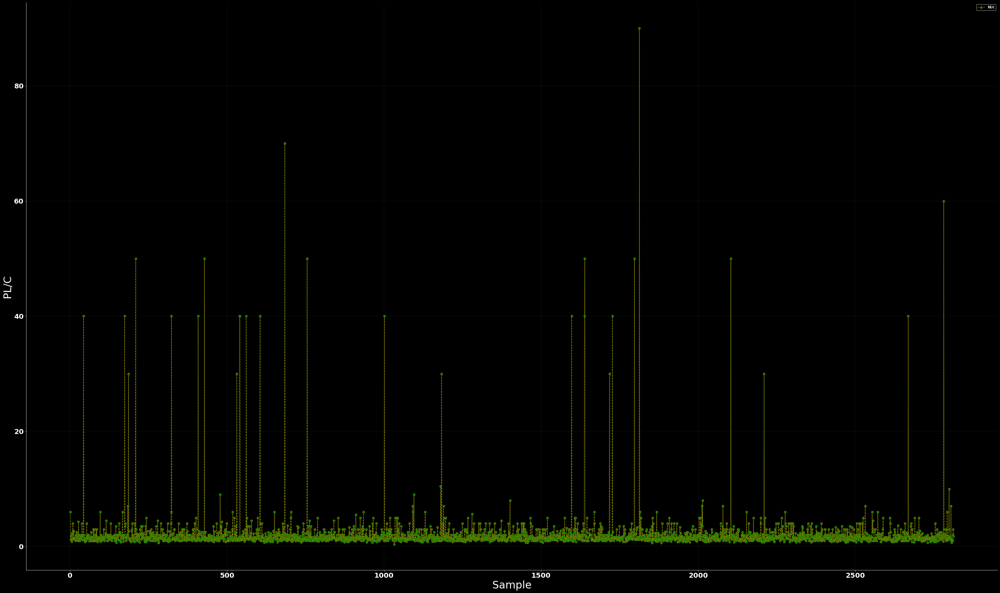

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:163: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

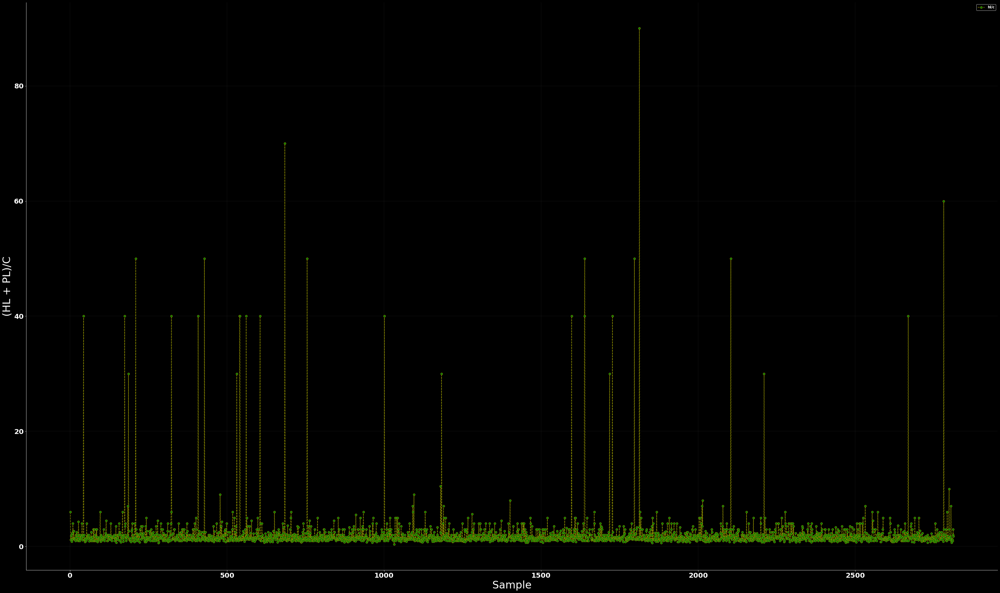

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:176: RuntimeWarning: Second argument 'y1' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

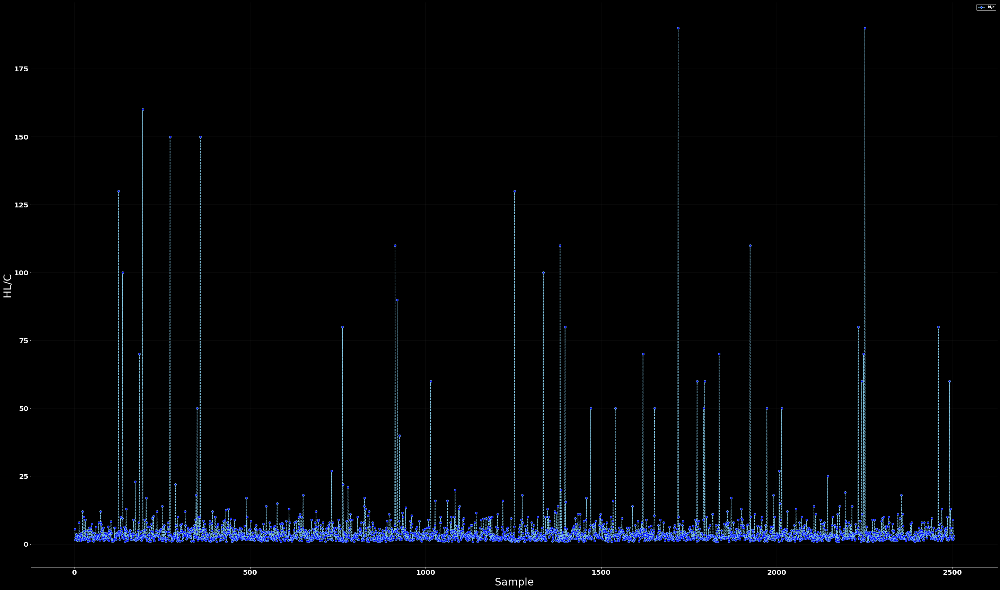

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:187: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

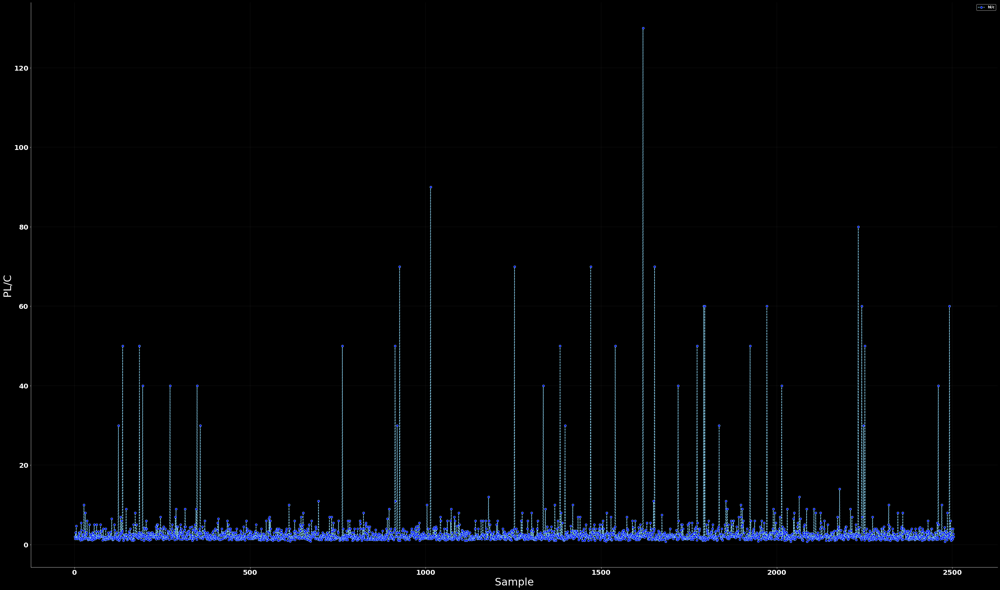

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:198: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

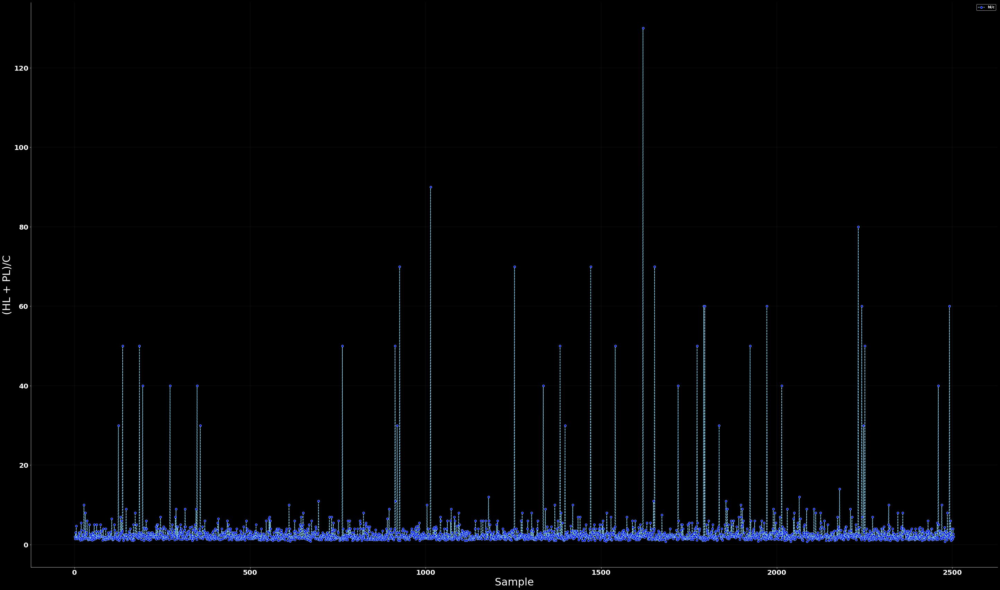

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:211: RuntimeWarning: Second argument 'y1' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

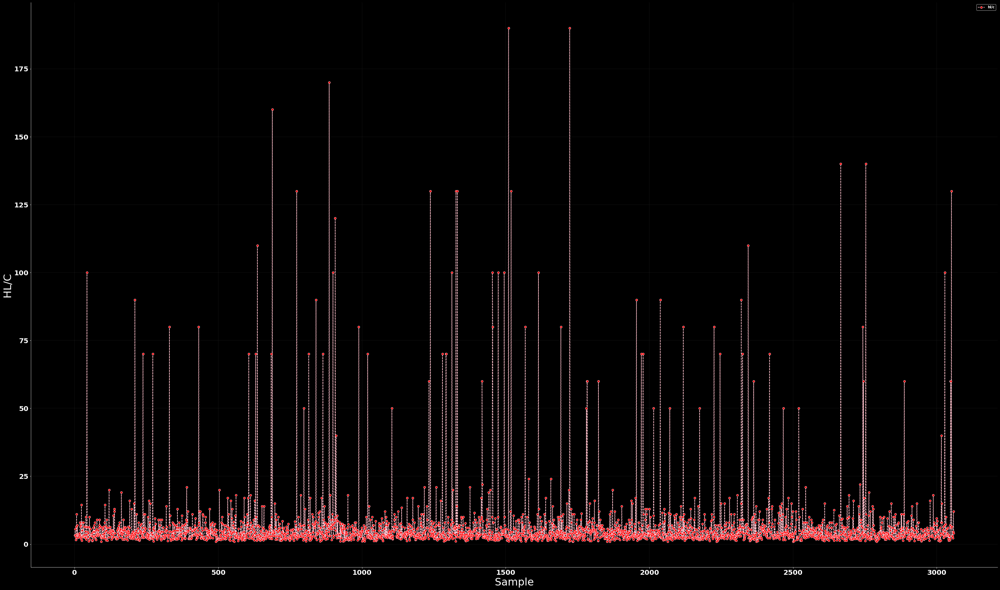

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:222: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

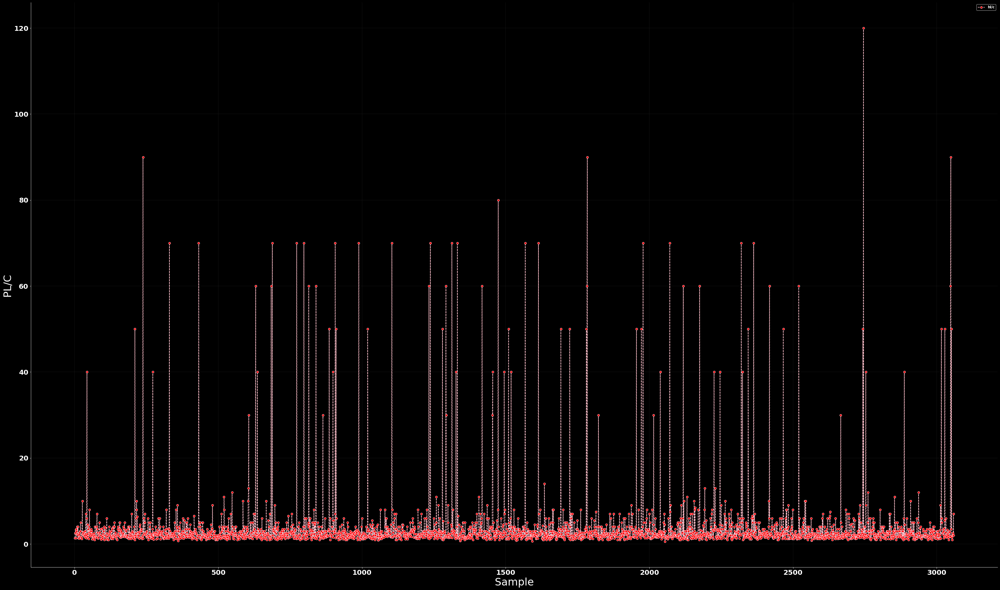

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:233: RuntimeWarning: Second argument 'y2' is ambiguous: could be a color spec but is in data; using as data.  Either rename the entry in data or use three arguments to plot.


<Figure size 432x288 with 0 Axes>

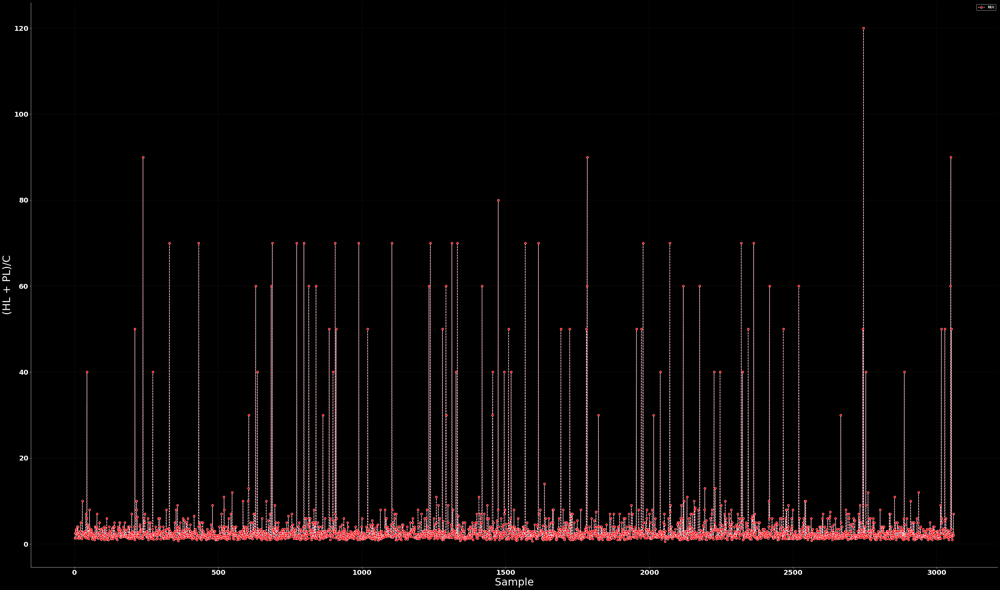

<Figure size 432x288 with 0 Axes>

In [54]:
#Word Overlap With Stop Words Bad
def final(x):
    makeitastring = ' '.join(map(str, x))
    makeitastring=makeitastring.replace(",","")
    makeitastring=makeitastring.replace("'","")
    makeitastring=makeitastring.replace("[","")
    makeitastring=makeitastring.replace("]","")
    return makeitastring
c0=0
arr=[]
arr1=[]
arr2=[]
arr3=[]
x=int(len(bwords)/2)
for i in tqdm(range(x)):
    s=bwords.iloc[i]['fullnopunc']
    s=s.lower()
    slist=s.split()
    slist = list(dict.fromkeys(slist))
    ss=bwords.iloc[i+x]['fullnopunc']
    sslist=ss.split()
    sslist = list(dict.fromkeys(sslist))
    s=final(slist)
    ss=final(sslist)
    hl=len(slist)
    pl=len(sslist)
    slist=s.split()
    c=0
    for j in range(len(slist)):
         if(slist[j] in ss):
                c=c+1
    if(c==0):
        c0=c0+1
        c=c+0.1
    arr.append(c)
    arr1.append(hl/c)
    arr2.append(pl/c)
    arr3.append((hl+pl)/c)
xaxis=[]
e=[]
n=[]
c=[]
for i in range(0,int(max(arr))+1):
    xaxis.append(i)
    e.append(0)
    n.append(0)
    c.append(0)
for i in range(len(xaxis)):
    for j in range(len(arr)):
        if(math.floor(arr[j])==xaxis[i]):
            if(labelphb[j]=='entailment'):
                e[i]=e[i]+1
            elif(labelphb[j]=='neutral'):
                n[i]=n[i]+1
            else:
                c[i]=c[i]+1

from matplotlib import cm
from math import log10
labels = xaxis
data = e
nn = len(data)
k = 10 ** int(log10(max(data)))
m = k * (1 + max(data) // k)
plt.style.use('dark_background')
r = 1.5
w = r / nn
colors = [cm.RdYlGn(i / nn) for i in range(nn)]
fig, ax = plt.subplots(figsize=(5,5))
ax.axis("equal")
for i in range(nn):
    innerring, _ = ax.pie([m - data[i], data[i]], radius = r - i * w, startangle = 90, labels = ["", labels[i]], labeldistance = 1 - 1 / (1.5 * (nn - i)), textprops = {"alpha": 0}, colors = ["black", colors[i]])
    plt.setp(innerring, width = w, edgecolor = "white")
plt.show()
plt.clf()
from matplotlib import cm
from math import log10
labels = xaxis
data = n
nn = len(data)
k = 10 ** int(log10(max(data)))
m = k * (1 + max(data) // k)
plt.style.use('dark_background')
r = 1.5
w = r / nn
colors = [cm.RdYlGn(i / nn) for i in range(nn)]
fig, ax = plt.subplots(figsize=(5,5))
ax.axis("equal")
for i in range(nn):
    innerring, _ = ax.pie([m - data[i], data[i]], radius = r - i * w, startangle = 90, labels = ["", labels[i]], labeldistance = 1 - 1 / (1.5 * (nn - i)), textprops = {"alpha": 0}, colors = ["black", colors[i]])
    plt.setp(innerring, width = w, edgecolor = "white")
plt.show()
from matplotlib import cm
from math import log10
labels = xaxis
data = c
nn = len(data)
k = 10 ** int(log10(max(data)))
m = k * (1 + max(data) // k)
plt.style.use('dark_background')
r = 1.5
w = r / nn
colors = [cm.RdYlGn(i / nn) for i in range(nn)]
fig, ax = plt.subplots(figsize=(5,5))
ax.axis("equal")
for i in range(nn):
    innerring, _ = ax.pie([m - data[i], data[i]], radius = r - i * w, startangle = 90, labels = ["", labels[i]], labeldistance = 1 - 1 / (1.5 * (nn - i)), textprops = {"alpha": 0}, colors = ["black", colors[i]])
    plt.setp(innerring, width = w, edgecolor = "white")
plt.show()

e1=[]
e2=[]
e3=[]
n1=[]
n2=[]
n3=[]
c1=[]
c2=[]
c3=[]
for i in range(len(arr1)):
    if(labelphb[i]=='entailment'):
        e1.append(arr1[i])
        e2.append(arr2[i])
        e3.append(arr3[i])
    elif(labelphb[i]=='neutral'):
        n1.append(arr1[i])
        n2.append(arr2[i])
        n3.append(arr3[i])
    else:
        c1.append(arr1[i])
        c2.append(arr2[i])
        c3.append(arr3[i])

df=pd.DataFrame({'x': range(1,len(e1)+1), 'y1': e1, 'y2': e2, 'y3': e3 })
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('HL/C',fontsize=30)
ax.plot( 'x', 'y1', data=df, marker='o', markerfacecolor='green' , color='olive',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('PL/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='green' , color='olive',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('(HL + PL)/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='green' , color='olive',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()

df=pd.DataFrame({'x': range(1,len(n1)+1), 'y1': n1, 'y2': n2, 'y3': n3 })
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('HL/C',fontsize=30)
ax.plot( 'x', 'y1', data=df, marker='o', markerfacecolor='blue' , color='skyblue',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('PL/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='blue' , color='skyblue',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('(HL + PL)/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='blue' , color='skyblue',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()

df=pd.DataFrame({'x': range(1,len(c1)+1), 'y1': c1, 'y2': c2, 'y3': c3 })
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('HL/C',fontsize=30)
ax.plot( 'x', 'y1', data=df, marker='o', markerfacecolor='red' , color='pink',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('PL/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='red' , color='pink',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()
fig, ax = plt.subplots(figsize=(50,30))
ax.grid(color='grey', linestyle='-', linewidth=0.25, alpha=0.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlabel('Sample',fontsize=30)
ax.set_ylabel('(HL + PL)/C',fontsize=30)
ax.plot( 'x', 'y2', data=df, marker='o', markerfacecolor='red' , color='pink',linestyle='dashed', label="hl/c")
ax.tick_params(axis='both', which='major', labelsize=20)
plt.legend()
plt.show() 
plt.clf()

bad['osc']=arr
bad['oshc']=arr1
bad['ospc']=arr2
bad['oshpc']=arr3

In [55]:
bad

,sample,p,h,lengthph,label,onsc,onshc,onspc,onshpc,osc,oshc,ospc,oshpc
0,0,This church choir sings to the masses as they ...,The church is filled with song,12,entailment,2.0,4.000000,1.500000,5.500000,1.0,16.000000,6.000000,22.000000
1,1,This church choir sings to the masses as they ...,A choir singing at a baseball game,11,contradiction,2.0,4.000000,2.000000,6.000000,5.0,3.200000,1.400000,4.600000
2,2,A woman with a green headscarf blue shirt and ...,The woman is young,9,neutral,1.0,7.000000,2.000000,9.000000,2.0,5.500000,2.000000,7.500000
3,3,A woman with a green headscarf blue shirt and ...,The woman has been shot,8,contradiction,1.0,7.000000,2.000000,9.000000,2.0,5.500000,2.500000,8.000000
4,4,An old man with a package poses in front of an...,A man poses in front of an ad,4,entailment,3.0,2.000000,1.333333,3.333333,7.0,1.571429,1.142857,2.714286
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8371,8371,Two women are observing something together,Two women are looking at a flower together,-2,neutral,3.0,1.666667,1.666667,3.333333,3.0,2.000000,2.666667,4.666667
8372,8372,Two women are observing something together,Two girls are looking at something,0,entailment,2.0,2.500000,2.000000,4.500000,2.0,3.000000,3.000000,6.000000
8373,8373,A man in a black leather jacket and a book in ...,A man is flying a kite,11,contradiction,1.0,8.000000,3.000000,11.000000,3.0,4.000000,2.000000,6.000000
8374,8374,A man in a black leather jacket and a book in ...,A man is speaking in a classroom,10,entailment,2.0,4.000000,1.500000,5.500000,4.0,3.000000,1.750000,4.750000


In [56]:
#Word sim- w and w/o stop
#Similarity PH

In [57]:
nlp = spacy.load("en_trf_bertbaseuncased_lg")

In [ ]:
def final(x):
    makeitastring = ' '.join(map(str, x))
    makeitastring=makeitastring.replace(",","")
    makeitastring=makeitastring.replace("'","")
    makeitastring=makeitastring.replace("[","")
    makeitastring=makeitastring.replace("]","")
    return makeitastring


x=int(len(bwords)/2)
arr1=[]
for i in tqdm(range(x)):
    s=bwords.iloc[i]['fullnopunc']
    s=s.lower()
    slist=s.split()
    sxlist = list(dict.fromkeys(slist))
    ss=bwords.iloc[i+x]['fullnopunc']
    sslist=ss.split()
    ssxlist = list(dict.fromkeys(sslist))
    sx=final(sxlist)
    ssx=final(ssxlist)
    sxlist=sx.split()
    hl=len(sxlist)
    pl=len(ssxlist)
    c=0
    for j in tqdm(range(len(sxlist))):
        arr=[]
        for k in range(len(ssxlist)):
            arr.append(nlp(sxlist[j]).similarity(nlp(ssxlist[k])))
        arr1.append(pd.Series(arr).max())


In [78]:
len(arr1)
wordmax=pd.DataFrame(arr1[90000:])
wordmax.to_csv('./wordmaxforeachbad/wordmaxforeachbad10.csv')

In [72]:
#PARAMETER 5
simarr=[]
df = pd.DataFrame(columns=['p', 'h'], data=df_testbad[['sentence1','sentence2']].values)
df['p'] = df['p'].str.replace("'", "")
df['p'] = df['p'].str.replace(".", "")
df['p'] = df['p'].str.replace(",", "")
df['h'] = df['h'].str.replace("'", "")
df['h'] = df['h'].str.replace(".", "")
df['h'] = df['h'].str.replace(",", "")

for i in tqdm(range(8376)):
    simarr.append((nlp(df.loc[i,'p'])).similarity(nlp(df.loc[i,'h'])))
print(simarr)


[0.7225314138875749, 0.72811546501242, 0.635689187162157, 0.5890379715954085, 0.9110920903611205, 0.9187296842402405, 0.7280296811303477, 0.7853578780803286, 0.6670540107127766, 0.7898386026462262, 0.8490948779660311, 0.8552825232665526, 0.9747773507367117, 0.7548252666431661, 0.7245898052114337, 0.6828783843590982, 0.6983888757540936, 0.8183255827940324, 0.7646798568680383, 0.6891613072504176, 0.7798171032873915, 0.5358143763331203, 0.7559778236397205, 0.8114943967804698, 0.7818545388271014, 0.8201186260106332, 0.6297996838164851, 0.7595537193551607, 0.7581866254382583, 0.7566695475137009, 0.7672795165212071, 0.7015746600942724, 0.8445425175657412, 0.7684899282104963, 0.7752862517160258, 0.8127995866392173, 0.7590227725076542, 0.7018135467313585, 0.8015512898860169, 0.7984807165529793, 0.7509140720538855, 0.8039757797016153, 0.8432397772638301, 0.7530637174408488, 0.7473293534410578, 0.8057551193602421, 0.7348041536507086, 0.6648025459013311, 0.6818188158225023, 0.683584536516692, 0.

In [73]:
bad['sim']=simarr
bad

,sample,p,h,lengthph,label,onsc,onshc,onspc,onshpc,osc,oshc,ospc,oshpc,sim
0,0,This church choir sings to the masses as they ...,The church is filled with song,12,entailment,2.0,4.000000,1.500000,5.500000,1.0,16.000000,6.000000,22.000000,0.722531
1,1,This church choir sings to the masses as they ...,A choir singing at a baseball game,11,contradiction,2.0,4.000000,2.000000,6.000000,5.0,3.200000,1.400000,4.600000,0.728115
2,2,A woman with a green headscarf blue shirt and ...,The woman is young,9,neutral,1.0,7.000000,2.000000,9.000000,2.0,5.500000,2.000000,7.500000,0.635689
3,3,A woman with a green headscarf blue shirt and ...,The woman has been shot,8,contradiction,1.0,7.000000,2.000000,9.000000,2.0,5.500000,2.500000,8.000000,0.589038
4,4,An old man with a package poses in front of an...,A man poses in front of an ad,4,entailment,3.0,2.000000,1.333333,3.333333,7.0,1.571429,1.142857,2.714286,0.911092
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8371,8371,Two women are observing something together,Two women are looking at a flower together,-2,neutral,3.0,1.666667,1.666667,3.333333,3.0,2.000000,2.666667,4.666667,0.889806
8372,8372,Two women are observing something together,Two girls are looking at something,0,entailment,2.0,2.500000,2.000000,4.500000,2.0,3.000000,3.000000,6.000000,0.857652
8373,8373,A man in a black leather jacket and a book in ...,A man is flying a kite,11,contradiction,1.0,8.000000,3.000000,11.000000,3.0,4.000000,2.000000,6.000000,0.774059
8374,8374,A man in a black leather jacket and a book in ...,A man is speaking in a classroom,10,entailment,2.0,4.000000,1.500000,5.500000,4.0,3.000000,1.750000,4.750000,0.858114


In [74]:
bad.to_csv('./testbadefficacy.csv')

In [79]:
magwordsbs=bwords.final.str.split(expand=True).stack().value_counts()
magwordsb=bwords.fullnopunc.str.split(expand=True).stack().value_counts()

In [80]:
pd.DataFrame(magwordsb).to_csv('./wordswithstopbad.csv')

In [81]:
pd.DataFrame(magwordsbs).to_csv('./wordswithoutstopbad.csv')

In [82]:
tagged=nltk.pos_tag(magwordsbs.index)
tagged
tagged_reduced_adjective = set()
tagged_reduced_verbs = set()
tagged_reduced_adverbs = set()
tagged_reduced_nouns = set()
for speech_tag in tagged:
    if speech_tag[1] in ['JJ','JJR','JJS']:
        tagged_reduced_adjective.add(speech_tag[0])
    elif speech_tag[1] in ['RB','RBR','RBS']:
        tagged_reduced_adverbs.add(speech_tag[0])
    elif speech_tag[1] in ['VB','VBD','VBG','VBN','VBP','VBZ']:
        tagged_reduced_verbs.add(speech_tag[0])
    elif speech_tag[1] in ['NN','NNS','NNP','NNPS']:
        tagged_reduced_nouns.add(speech_tag[0])

In [83]:
wordposcount=[]

for i in range(len(magwordsbs)):
    wordposcount.append(0)

for i in range(len(magwordsbs)):
    if(magwordsbs.index[i] in tagged_reduced_adjective):
        wordposcount[i]=wordposcount[i]+1
    elif(magwordsbs.index[i] in tagged_reduced_adverbs):
        wordposcount[i]=wordposcount[i]+1
    elif(magwordsbs.index[i] in tagged_reduced_verbs):
        wordposcount[i]=wordposcount[i]+1
    elif(magwordsbs.index[i] in tagged_reduced_nouns):
        wordposcount[i]=wordposcount[i]+1

In [84]:
df=pd.DataFrame(columns=['word','homonym'])
df['word']=magwordsbs.index
df['homonym']=wordposcount
df

,word,homonym
0,man,1
1,woman,1
2,two,0
3,people,1
4,wearing,1
...,...,...
5369,stationary,1
5370,norwegian,1
5371,dine,1
5372,identity,1


In [85]:
for i in range(len(df)):
    if(df.iloc[i]['homonym']>1):
        print(df.iloc[i]['word'])

In [88]:
prepositions=['about', 'after', 'at', 'before', 'behind', 'by', 'during', 'for', 'from', 'in', 'of', 'over', 'past', 'to', 'under', 'up', 'with']
for i in range(len(magwordsb)):
    if(magwordsb.index[i] in prepositions):
        print(magwordsb.index[i],magwordsb[i]/len(df_testbad))

in 0.7985912129894938
of 0.39099808978032474
with 0.3351241642788921
to 0.22576408787010507
at 0.18553008595988538
for 0.07617000955109837
by 0.05718720152817574
up 0.05074021012416428
from 0.041189111747851004
over 0.0313992359121299
behind 0.02328080229226361
about 0.017788920725883478
during 0.010386819484240688
after 0.010148042024832856
under 0.01002865329512894
past 0.0070439350525310414
before 0.0053724928366762174


In [89]:
print(tagged_reduced_adverbs)

{'far', 'aside', 'away', 'too', 'fossil', 'actually', 'still', 'woven', 'anger', 'flag', 'warmly', 'busily', 'handedly', 'carefully', 'alike', 'nicely', 'eachother', 'apron', 'oily', 'yet', 'washer', 'roughly', 'soon', 'vigorously', 'sharply', 'darkly', 'slowly', 'casually', 'formally', 'silently', 'really', 'escape', 'bully', 'mutt', 'upward', 'barely', 'competitively', 'quickly', 'overgrown', 'strip', 'otherwise', 'rightly', 'flock', 'defintely', 'walkway', 'dispenser', 'mostly', 'alleyway', 'closer', 'doorway', 'oddly', 'always', 'else', 'ever', 'already', 'angrily', 'smelly', 'lover', 'mate', 'score', 'newly', 'oven', 'differently', 'extremely', 'later', 'patiently', 'relentlessly', 'heavily', 'anxiously', 'soundly', 'everywhere', 'quietly', 'nervously', 'advertiser', 'eagerly', 'apparently', 'partly', 'nowhere', 'here', 'surfboard', 'medal', 'messily', 'wrong', 'swan', 'nose', 'possibly', 'hipster', 'loudly', 'again', 'sadly', 'cardboard', 'yoyo', 'skillfully', 'nearly', 'mob', 'm

In [90]:
for i in range(len(magwordsb)):
    if(magwordsb.index[i] in ['and','or']):
        print(magwordsb.index[i],magwordsb[i]/len(df_testbad))

and 0.4294412607449857
or 0.008118433619866285


In [91]:
for i in range(len(magwordsb)):
    if(magwordsb.index[i] in ['the','a','this','that','it']):
        print(magwordsb.index[i],magwordsb[i]/len(df_testbad))

a 1.78414517669532
the 0.6926934097421203
that 0.02829512893982808
it 0.0247134670487106
this 0.004775549188156638


In [92]:
len(tagged_reduced_adjective)/len(df_testbad)

0.1451766953199618